<H1> Image2Text Demo </H1>

In [1]:
import json
import shap
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt 
import os
import copy
import shutil
import pandas as pd
import matplotlib as mlp
import transformers
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from transformers import  BartForConditionalGeneration,BartTokenizer
import scipy as sp
import nlp
import torch
import sys
import requests
import time
from transformers.file_utils import ModelOutput
import pickle 
%matplotlib inline
from PIL import Image
from io import BytesIO
import cv2
from textwrap import wrap
from collections import defaultdict
import itertools
#import time
#from matplotlib.patches import Polygon
#from PIL import Image
#from io import BytesIO

<h2> Image Captioning Helper Functions</h2>

In [2]:
# Subscription and API details 
API_KEY = "d61d546a88c34d67a2413dbda4c778a4"
ENDPOINT = "https://shapcv.cognitiveservices.azure.com/"
ANALYZE_URL = ENDPOINT + "/vision/v3.1/analyze"

# Directory for saving masked images
# Creates a new folder called 'masked_images' if it doesn't already exist in the current folder
DIR = './masked_images/'
if not os.path.exists(DIR):
    os.makedirs(DIR) 

In [3]:
# Helper function to get an image caption when path to image file is given 
def get_caption(path_to_image):
    path_to_image = DIR + path_to_image
    headers  = {
        'Ocp-Apim-Subscription-Key': API_KEY,
        'Content-Type': 'application/octet-stream'
    }
    params   = {
        'visualFeatures': 'Description',
        'language': 'en',
    }
    payload = open(path_to_image, 'rb').read()
    response = requests.post(ANALYZE_URL, headers=headers, params=params, data=payload)
    results = json.loads(response.content)
    # return the first caption's text in results description section 
    return results['description']['captions'][0]['text']

# Helper function to save the image with given filename and array of pixel values 
def save_image(pixel_array, file_name):
    # saving array of RGB values as an image 
    image = np.array(pixel_array)/255.0
    file_name = DIR + file_name
    plt.imsave(file_name, image)

<h2> Transformer Helper Functions for Captions Alignment Scoring </h2>

In [4]:
# Creating an instance of BART Tokenizer and BART model for Text Summarization Conditional Generation 
tokenizer = BartTokenizer.from_pretrained("sshleifer/distilbart-xsum-12-6")
model =  BartForConditionalGeneration.from_pretrained("sshleifer/distilbart-xsum-12-6").cuda()

def cuda_memory_stats():
    t = torch.cuda.get_device_properties(0).total_memory
    c = torch.cuda.memory_cached(0)
    a = torch.cuda.memory_allocated(0)
    f = c-a
    print(t)
    print(c)
    print(a)
    print(f)
# cuda_memory_stats()

# Helper function for calculating logits 
def get_teacher_forced_logits(model, input_ids, decoder_input_ids):
    with torch.no_grad():
        outputs = model(input_ids = input_ids, labels = decoder_input_ids, return_dict=True) # decoder_input_ids = decoder_input_ids,
    # output_names = tokenizer.convert_ids_to_tokens(outputs)
    logits = outputs.logits.detach().cpu().numpy()
    del outputs
    return logits

# Helper function for calculating logits 
def cal_conditional_logits(model, input_ids, decoder_input_ids, attention_mask=None):
    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
    input_ids = input_ids.to(device)
    decoder_input_ids = decoder_input_ids.to(device)
    conditional_logits = []
    logits = get_teacher_forced_logits(model, input_ids, decoder_input_ids)
    for i in range(1, logits.shape[1]):
        probs = (np.exp(logits[0][i-1]).T / np.exp(logits[0][i-1]).sum(-1)).T
        logit_dist = sp.special.logit(probs)
        conditional_logits.append(logit_dist[decoder_input_ids[0,i].item()])
    return np.array(conditional_logits)

# Get input_ids from the tokenizer for the original image caption and decode input_ids using tokenizer to get output_names aka labels
def gen_kwargs(x):
    inputs = tokenizer([x], max_length=512, return_tensors='pt', truncation=True)
    input_ids = inputs['input_ids'].cuda()
    with torch.no_grad():
        # generate input ids for output translation which we aim to explain
        out = model.generate(input_ids)
    # decoder_inputs=out[:,:-1]
    output_names = [tokenizer.decode(int(x)) for x in input_ids[0,1:].cpu().numpy()]
    del out
    return {'input_ids': input_ids, 'output_names': output_names} # 'decoder_inputs':decoder_inputs,

def f_kwargs(x):
    kwargs = gen_kwargs(x)
    return kwargs

# Function for scoring original image caption against masked image caption and return logits for each word in original image caption
def score(x_batch, **kwargs):
    output_batch = []
    # Extract decoder inputs for which we want to generate conditional logits
    decoder_inputs = kwargs['input_ids'] #['decoder_inputs']
    for i, x in enumerate(x_batch):
        inputs = tokenizer([x], max_length=1024, return_tensors='pt', truncation=True)
        input_ids = inputs['input_ids']
        conditional_logits = cal_conditional_logits(model, input_ids, decoder_inputs)
        output_batch.append(conditional_logits)
    return np.array(output_batch)

In [5]:
# Sample function calls for transformer functions

# original image caption
kwargs = f_kwargs("a bird on a branch") 
print(kwargs)

# sample masked image captions 
score(["a small bird perched on a branch", "closeup of a bird", "a bird flying in the sky"], **kwargs) 

{'input_ids': tensor([[   0,  102, 5103,   15,   10, 6084,    2]], device='cuda:0'), 'output_names': ['a', ' bird', ' on', ' a', ' branch', '</s>']}


array([[ -8.527824 ,  -8.634038 ,  -9.365795 ,  -6.7307696,  -8.460043 ,
         -9.826696 ],
       [-10.277658 ,  -8.253353 ,  -8.936632 ,  -7.021868 , -11.540035 ,
         -9.420046 ],
       [ -8.239232 , -10.039149 ,  -9.4179125,  -6.3807216, -11.686064 ,
         -8.903961 ]], dtype=float32)

<h2> Image2Text Algorithm Demo </h2>

<h3> Note: </h3> 

1. Analysis for images is run one-by-one using a loop. 
2. There are several factors which can be changed/experimented with: 
    1. Image Maskers: Inpainting vs Blurring 
    2. Fixed_Context: 0, 1 or None 
    3. Number of Evaluations: Typically between 300-500. As the number of evaluations increase, granularity of super pixel regions in final output increases. 
3. Grid plot showing intermediate masked images can be turned on or off 

<H3> Loading Data </H3>

In [6]:
X, y = shap.datasets.imagenet50()

# To see which index in imagenet50 corresponds to which image, saving images with index as the file name 
# Images get saved in DIR/image_net folder set above
imagenet_folder = DIR + "image_net/"
if not os.path.exists(imagenet_folder):
    os.makedirs(imagenet_folder) 

for i, image in enumerate(X):
    file_name = "image_net/" + str(i)+ ".png"
    save_image(image, file_name) 

<h3> Helper function for displaying masked images grid plot </H3>

In [7]:
def grid_display(list_of_images, list_of_titles=[], no_of_columns=2, figsize=(10,10)):

    fig = plt.figure(figsize=figsize)
    column = 0
    for i in range(len(list_of_images)):
        column += 1
        #  check for end of column and create a new figure
        if column == no_of_columns+1:
            fig = plt.figure(figsize=figsize)
            column = 1
        fig.add_subplot(1, no_of_columns, column)
        plt.imshow(list_of_images[i])
        plt.axis('off')
        if len(list_of_titles) >= len(list_of_images):
            plt.title("\n".join(wrap(str(list_of_titles[i]), width = 40)))

<H3> Helper functions for model to be evaluated: </H3>

**f_caption:**

1. Gets original image caption

2. Gets original image caption as input_ids and corresponding output_names for input_ids from tokenizer vocab

**f:**

1. Takes original image caption input_ids and restricts output of language model to be same as original image caption.  

2. Returns logits for alignment score between original image and masked image captions. 

In [8]:
image_counter = 0 
mask_level_counter = 0 
masked_image_captions = defaultdict(list)
masked_image_files = defaultdict(list)

# Get original image caption and return as input_ids and output_names from tokenizer
# This function creates additional keyword arguments which is passed onto the model function. 
def f_caption(original_image): 
    file_name = "original_image_" + str(image_counter) + ".png"
    save_image(original_image, file_name) # saving original image array of RGB values as an image 
    caption = get_caption(file_name) # getting masked image caption
    return f_kwargs(caption) # return caption as input_ids and output_names from tokenizer 

def f(x_batch): #def f(x_batch, **kwargs):
    outputs = []
    global mask_level_counter
    for i, masked_image in enumerate(x_batch): #(joined_masked_inputs[0]):
        file_name = str(image_counter) + "_mask_" + str(mask_level_counter) + "_" + str(i) + ".png"
        save_image(masked_image, file_name) # saving masked array of RGB values as an image 
        caption = get_caption(file_name) # getting masked image caption
        masked_image_captions[image_counter].append(caption)
        masked_image_files[image_counter].append(file_name)
        outputs.append(score([caption], **kwargs)[0]) # masked image caption scored by comparing with orginal image caption
    mask_level_counter += 1 
    return np.array(outputs)

<h3> For loop for running Image2Text on multiple images:</h3>

Partition explainer: 2it [00:35, 17.71s/it]               


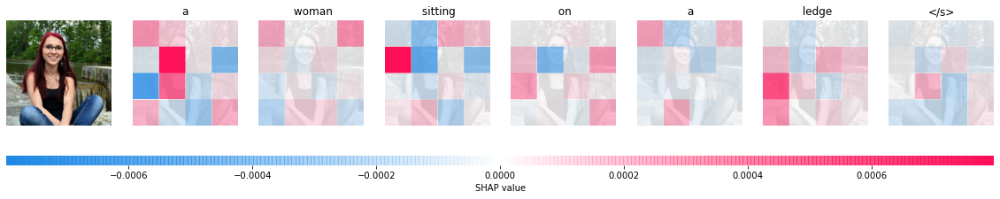

Partition explainer: 2it [00:32, 16.02s/it]               


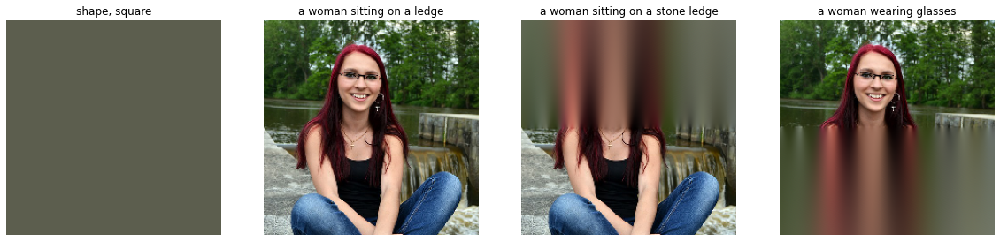

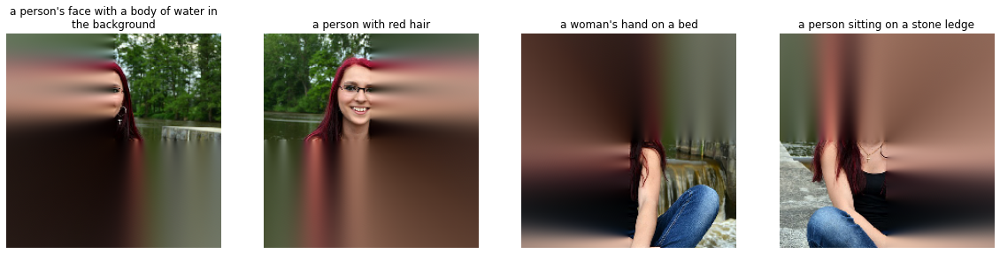

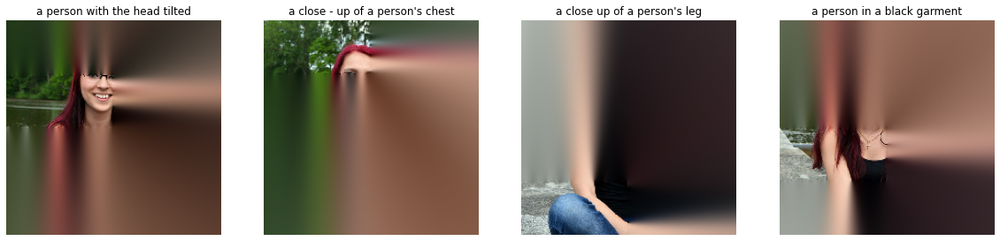

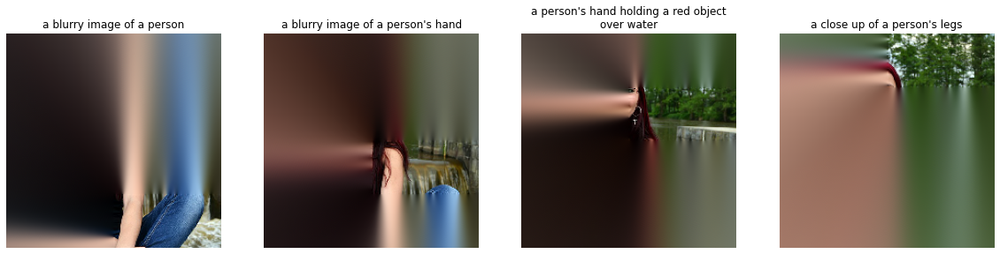

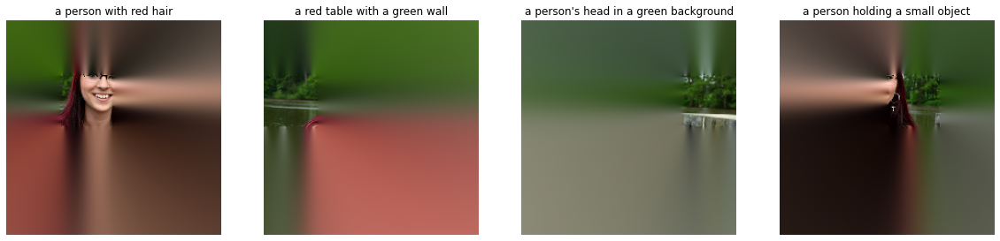

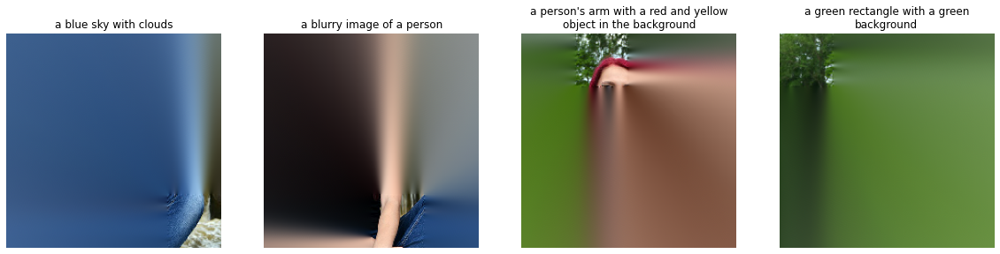

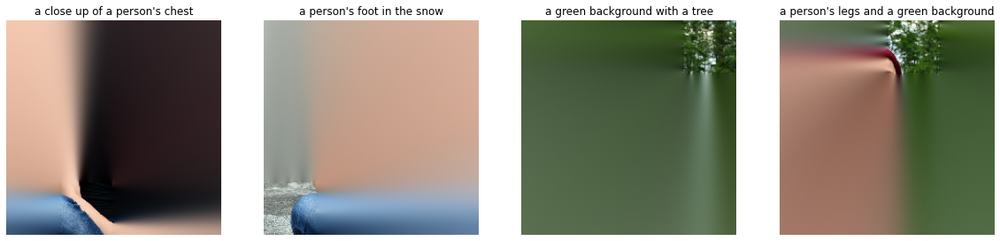

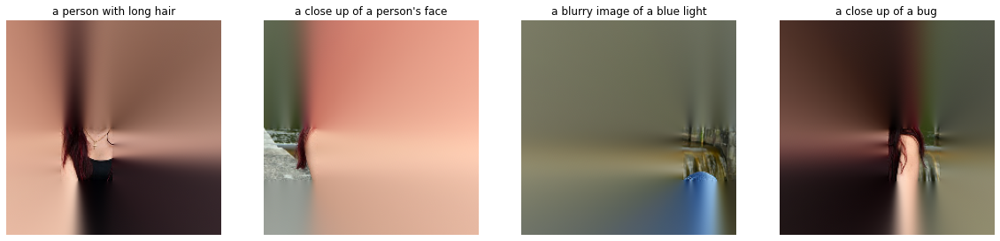

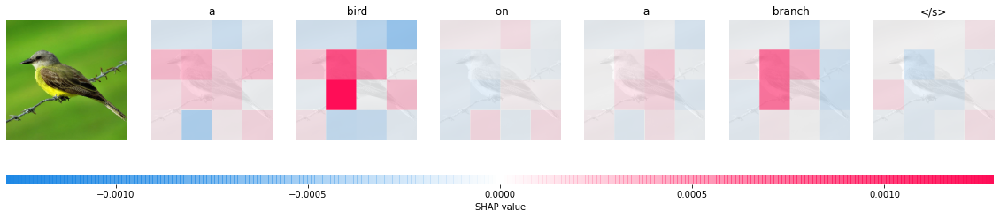

Partition explainer: 2it [00:39, 20.00s/it]               


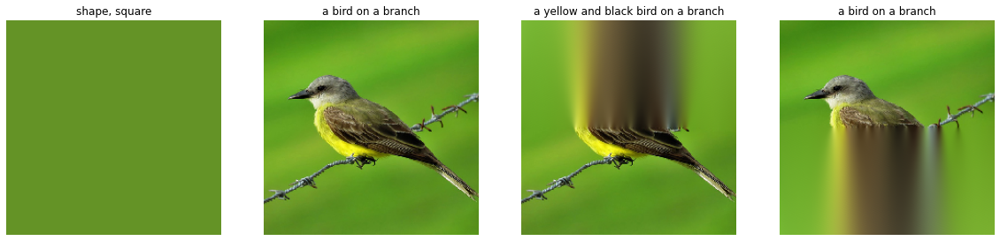

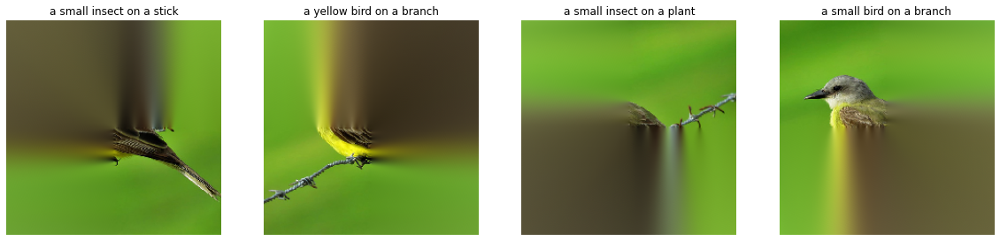

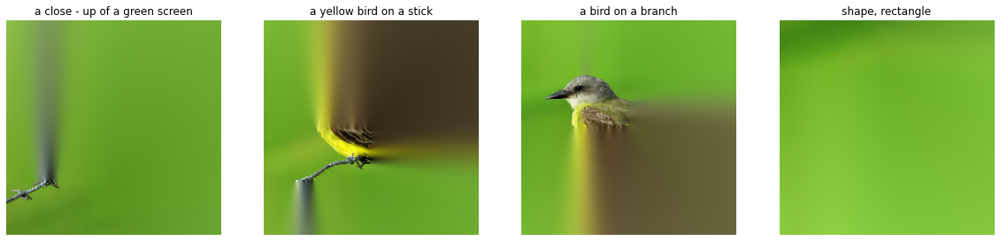

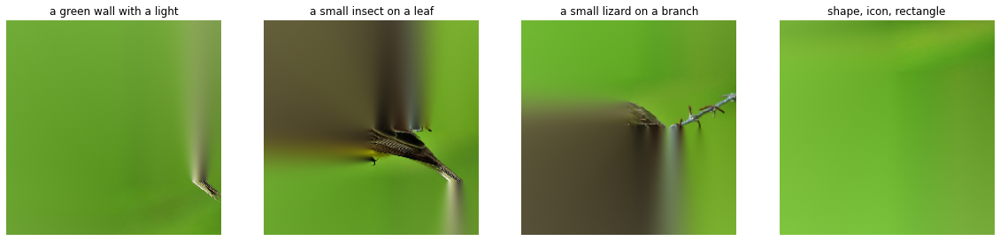

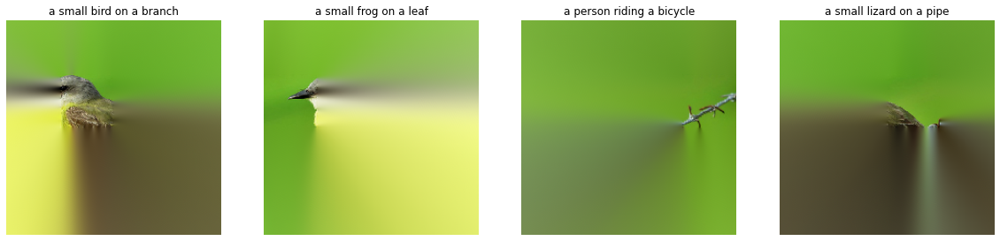

...

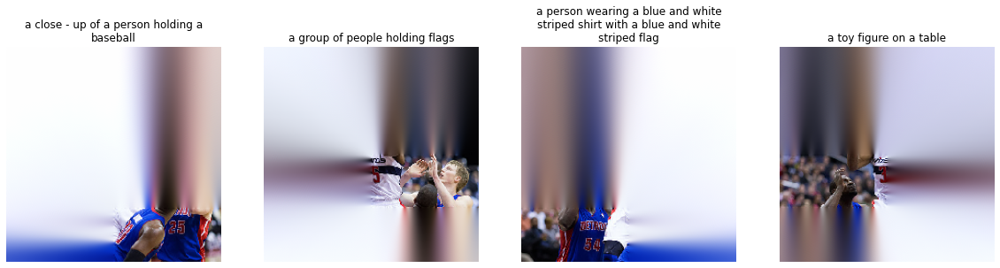

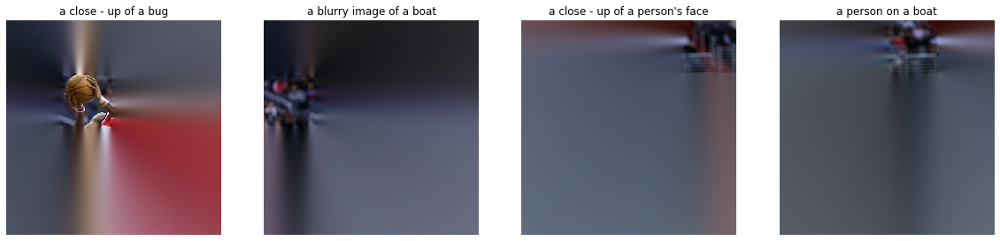

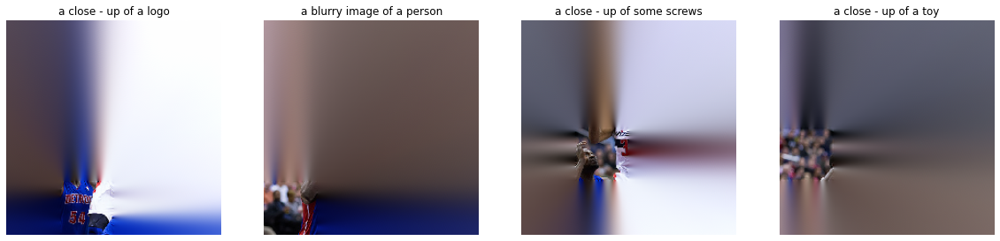

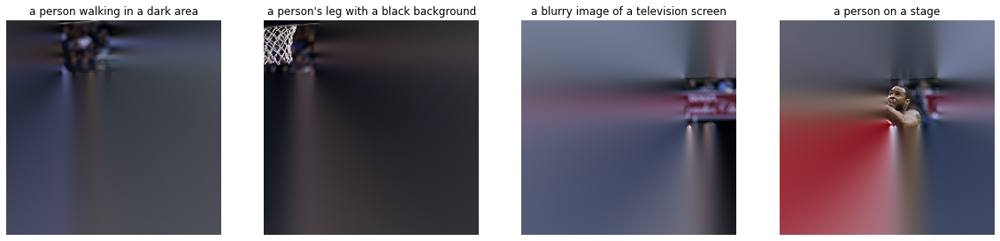

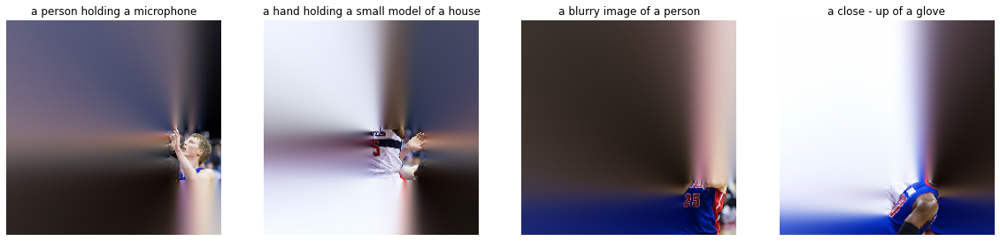

In [29]:
# resetting values for fresh run of for loop 
image_counter = 0 
mask_level_counter = 0 
masked_image_captions = defaultdict(list)
for filename in os.listdir(DIR):
    if filename.endswith(".png"):
        os.remove(DIR+filename)
masked_image_files = defaultdict(list)
show_grid_plot = True
kwargs ={}

image_indexes = [25, 26, 44]
for index in image_indexes:
    
    # get original image caption as input_ids and output_names (refer f_caption and gen_kwargs functions)
    kwargs = f_caption(*X[index:index+1])

    # define a masker that is used to mask out partitions of the input image, this one uses a blurred background
    masker = shap.maskers.Image("inpaint_telea", X[index].shape)

    # build a partition explainer with:
    # - the model (a python function)
    # - the masker (a python function)
    # - the partition tree (a python function)
    # - output names (a list of names of the output classes)
    explainer = shap.Explainer(f, masker) #explainer = shap.Explainer(f, masker, model_kwargs = f_caption)

    # here we use 50 evaluations of the underlying model to estimate the SHAP values
    shap_values = explainer(X[index:index+1], max_evals= 50, batch_size=50, fixed_context = 0) #outputs=shap.Explanation.argsort[:8]

    # output labels 
    output_names = [kwargs['output_names']] #output_names = explainer.output_names

    # output plot
    shap.image_plot(shap_values, labels = output_names)
    
    # grid plot for masked_images
    if show_grid_plot:
        titles = masked_image_captions[image_counter]
        masked_images = []
        for filename in masked_image_files[image_counter]:
                image = cv2.imread('{0}/{1}'.format(DIR, filename))
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
                masked_images.append(image)
        grid_display(masked_images, titles, 4, (20,20))

    # resetting values for loop next iterations
    mask_level_counter = 0 
    image_counter += 1
    kwargs ={}

<H2> Experiments for evaluating Image2Text algorithm: </H2>

Following options are being experimented with: 

1. fixed_context: 0, 1 or None
2. masker_options: "blur(kernel_xsize, kernel_xsize)", "inpaint_telea", or "inpaint_ns"

In [9]:
fixed_context_options = [0, 1 , None]
masker_options =  ["blur(56,56)", "inpaint_telea", "inpaint_ns"]
experiments = list(itertools.product(fixed_context_options, masker_options))
print(experiments)

[(0, 'blur(56,56)'), (0, 'inpaint_telea'), (0, 'inpaint_ns'), (1, 'blur(56,56)'), (1, 'inpaint_telea'), (1, 'inpaint_ns'), (None, 'blur(56,56)'), (None, 'inpaint_telea'), (None, 'inpaint_ns')]


Partition explainer: 2it [03:02, 91.25s/it]               
Fixed_context: 0 Masker_option: blur(56,56)


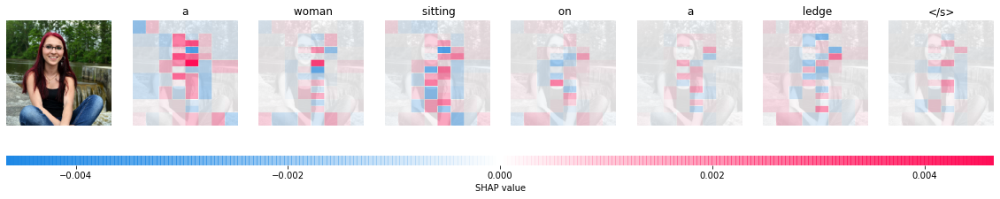

Partition explainer: 2it [03:17, 98.66s/it]               
Fixed_context: 0 Masker_option: inpaint_telea


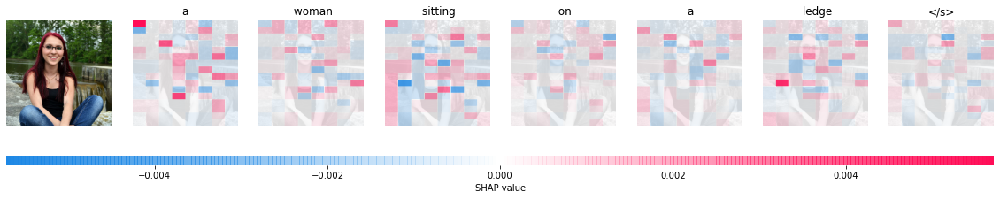

Partition explainer: 2it [02:52, 86.17s/it]               
Fixed_context: 0 Masker_option: inpaint_ns


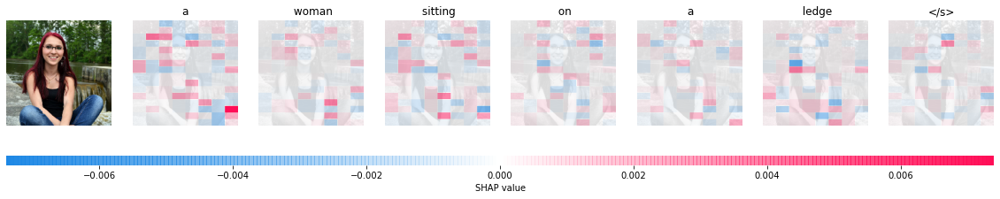

Partition explainer: 2it [03:41, 110.78s/it]              
Fixed_context: 1 Masker_option: blur(56,56)


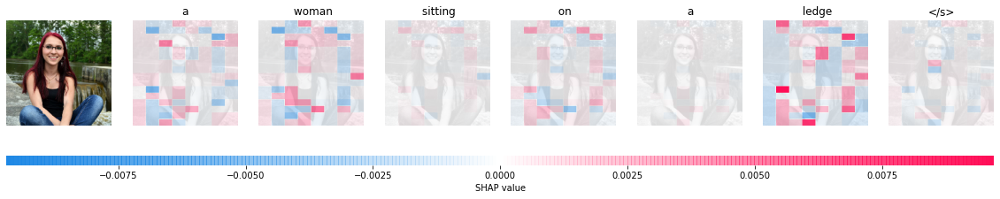

Partition explainer: 2it [04:18, 129.21s/it]              
Fixed_context: 1 Masker_option: inpaint_telea


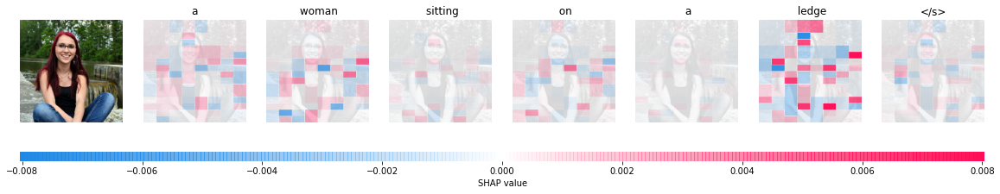

Partition explainer: 2it [03:48, 114.50s/it]              
Fixed_context: 1 Masker_option: inpaint_ns


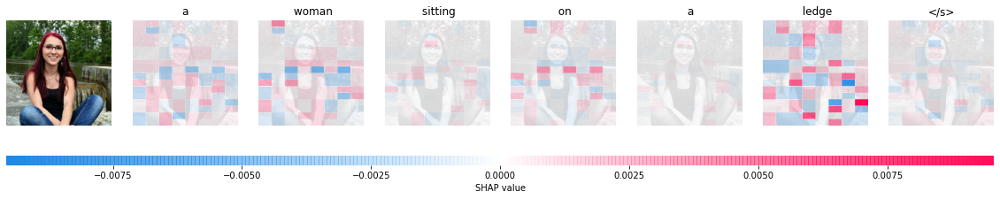

Partition explainer: 2it [03:40, 110.28s/it]              
Fixed_context: None Masker_option: blur(56,56)


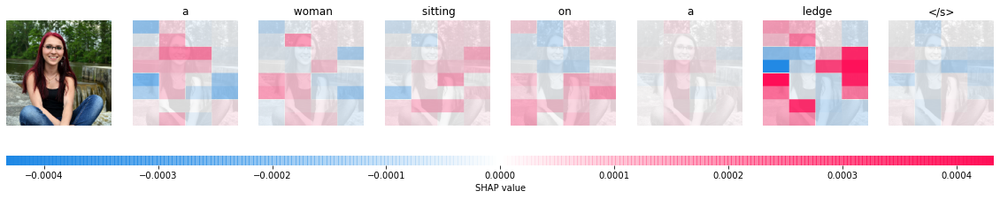

Partition explainer: 2it [03:59, 119.72s/it]              
Fixed_context: None Masker_option: inpaint_telea


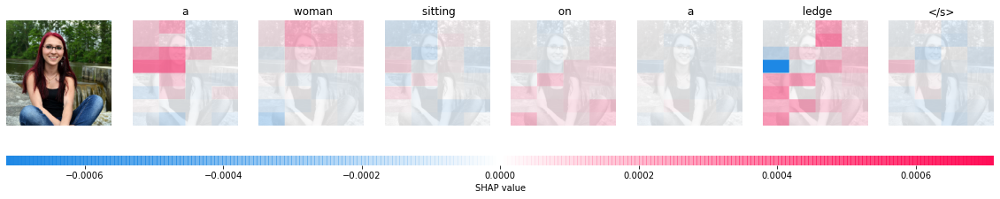

Partition explainer: 2it [03:48, 114.03s/it]              
Fixed_context: None Masker_option: inpaint_ns


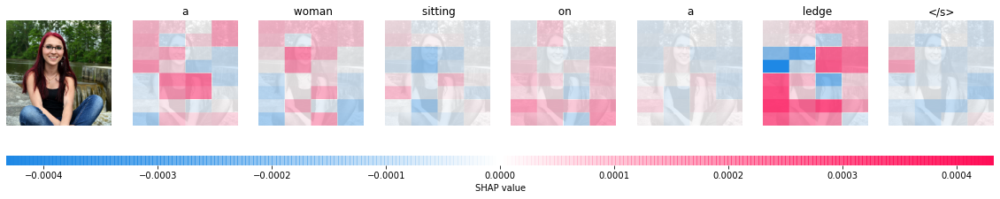

Partition explainer: 2it [02:32, 76.08s/it]               
Fixed_context: 0 Masker_option: blur(56,56)


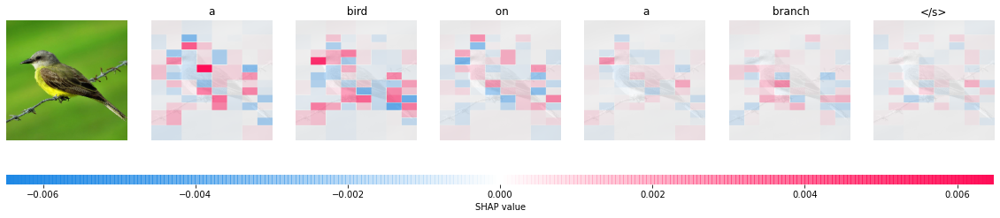

 78%|███████▊  | 116/148 [01:32<00:23,  1.39it/s]

ConnectionError: ('Connection aborted.', TimeoutError(10060, 'A connection attempt failed because the connected party did not properly respond after a period of time, or established connection failed because connected host has failed to respond', None, 10060, None))

In [12]:
# resetting values for fresh run of for loop 
image_counter = 0 
mask_level_counter = 0 
masked_image_captions = defaultdict(list)
for filename in os.listdir(DIR):
    if filename.endswith(".png"):
        os.remove(DIR+filename)
masked_image_files = defaultdict(list)
show_grid_plot = False
kwargs ={}

image_indexes = [25, 26, 44]
for index in image_indexes:
    for fixed_context_option, masker_option in experiments:
        # get original image caption as input_ids and output_names (refer f_caption and gen_kwargs functions)
        kwargs = f_caption(*X[index:index+1])

        # define a masker that is used to mask out partitions of the input image
        masker = shap.maskers.Image(masker_option, X[index].shape)

        # build a partition explainer with:
        # - the model (a python function)
        # - the masker (a python function)
        # - the partition tree (a python function)
        # - output names (a list of names of the output classes)
        explainer = shap.Explainer(f, masker) #explainer = shap.Explainer(f, masker, model_kwargs = f_caption)

        # here we use 300 evaluations of the underlying model to estimate the SHAP values
        shap_values = explainer(X[index:index+1], max_evals= 300, batch_size=50, fixed_context = fixed_context_option)

        # output labels 
        output_names = [kwargs['output_names']] #output_names = explainer.output_names

        # output plot
        print("Fixed_context:", fixed_context_option, "Masker_option:", masker_option)
        shap.image_plot(shap_values, labels = output_names)
        
        # grid plot for masked_images
        if show_grid_plot:
            titles = masked_image_captions[image_counter]
            masked_images = []
            for filename in masked_image_files[image_counter]:
                    image = cv2.imread('{0}/{1}'.format(DIR, filename))
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
                    masked_images.append(image)
            grid_display(masked_images, titles, 4, (20,20))

        # resetting values for loop next iterations
        mask_level_counter = 0 
        image_counter += 1
        kwargs ={}


 78%|███████▊  | 116/148 [01:46<00:26,  1.23it/s]
166it [02:29,  1.20it/s]                         
                        
Partition explainer: 2it [02:40, 80.10s/it]               
Fixed_context: 0 Masker_option: blur(56,56)


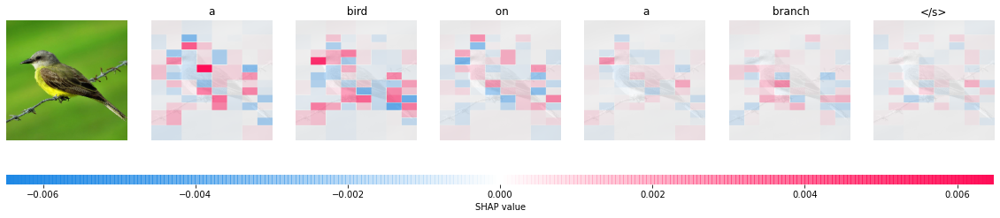


 78%|███████▊  | 116/148 [01:40<00:25,  1.27it/s]
166it [02:36,  1.12it/s]                         
                        
Partition explainer: 2it [02:48, 84.16s/it]               
Fixed_context: 0 Masker_option: inpaint_telea


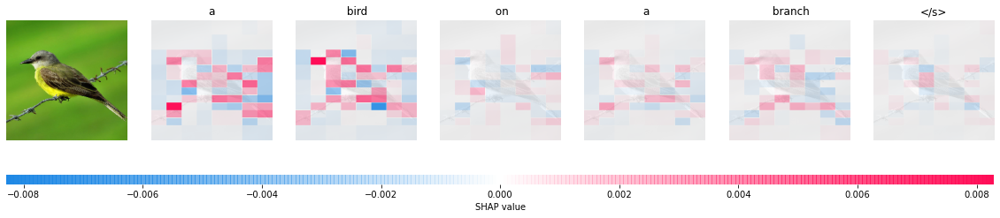


 78%|███████▊  | 116/148 [01:22<00:20,  1.55it/s]
166it [02:00,  1.47it/s]                         
                        
Partition explainer: 2it [02:10, 65.38s/it]               
Fixed_context: 0 Masker_option: inpaint_ns


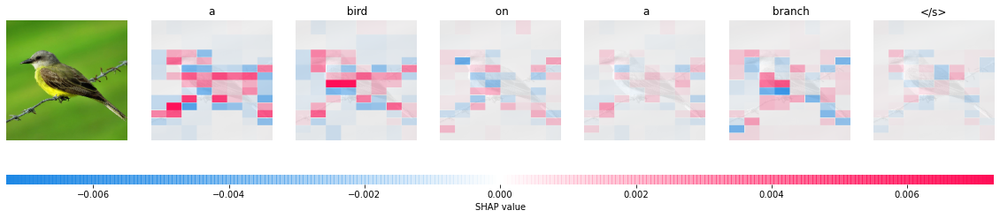


 78%|███████▊  | 116/148 [02:00<00:28,  1.11it/s]
166it [02:54,  1.04it/s]                         
                        
Partition explainer: 2it [03:04, 92.46s/it]               
Fixed_context: 1 Masker_option: blur(56,56)


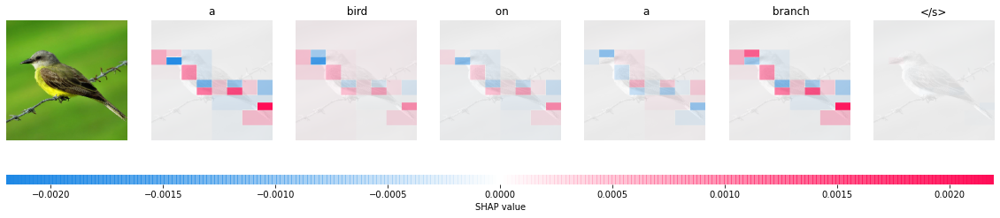


 78%|███████▊  | 116/148 [01:58<00:29,  1.09it/s]
166it [02:58,  1.00it/s]                         
                        
Partition explainer: 2it [03:12, 96.24s/it]               
Fixed_context: 1 Masker_option: inpaint_telea


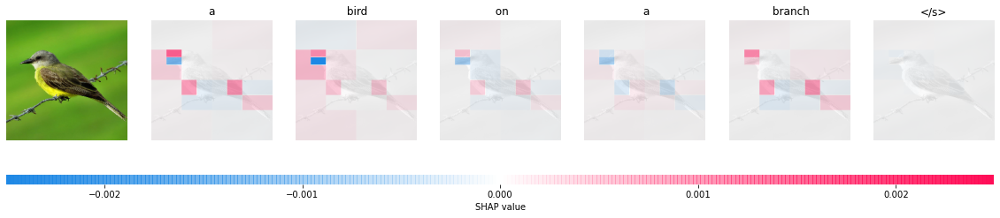


 78%|███████▊  | 116/148 [02:01<00:31,  1.03it/s]
166it [02:56,  1.01s/it]                         
                        
Partition explainer: 2it [03:08, 94.09s/it]               
Fixed_context: 1 Masker_option: inpaint_ns


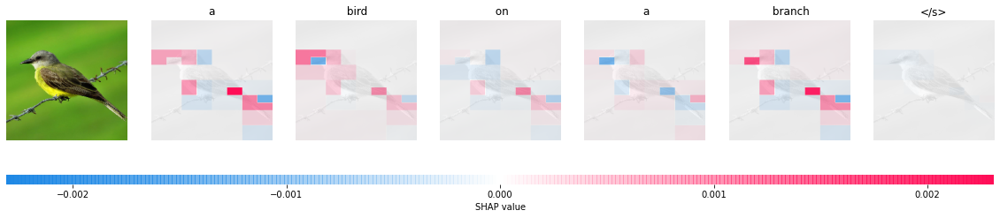


 81%|████████  | 200/248 [03:13<00:44,  1.08it/s]
250it [04:08,  1.02it/s]                         
300it [05:03,  1.02s/it]
                        
Partition explainer: 2it [05:19, 159.68s/it]              
Fixed_context: None Masker_option: blur(56,56)


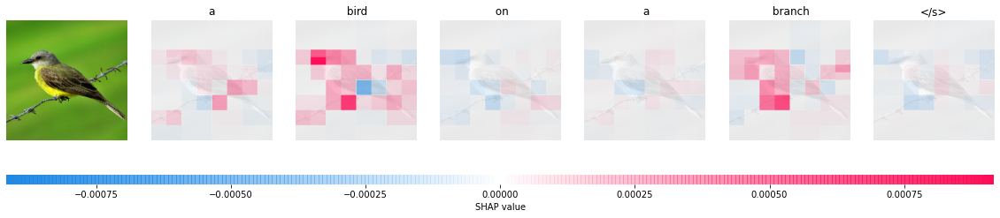


 81%|████████  | 200/248 [03:35<00:49,  1.03s/it]
250it [04:33,  1.07s/it]                         
300it [05:31,  1.09s/it]
                        
Partition explainer: 2it [05:46, 173.20s/it]              
Fixed_context: None Masker_option: inpaint_telea


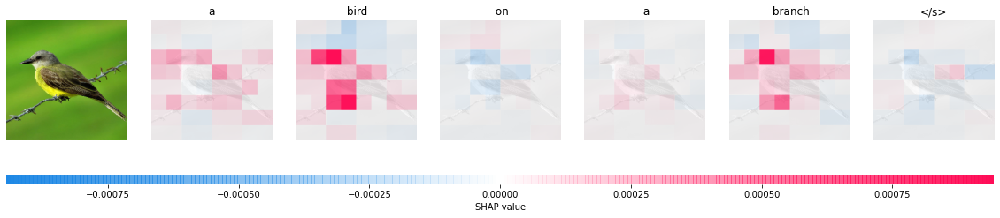


 81%|████████  | 200/248 [03:20<00:46,  1.03it/s]
250it [04:13,  1.01it/s]                         
300it [05:07,  1.02s/it]
                        
Partition explainer: 2it [05:22, 161.33s/it]              
Fixed_context: None Masker_option: inpaint_ns


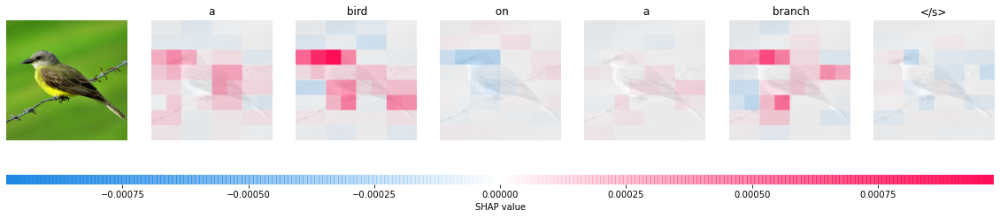


 78%|███████▊  | 116/148 [01:56<00:28,  1.11it/s]
166it [02:52,  1.03it/s]                         
                        
Partition explainer: 2it [03:09, 94.51s/it]               
Fixed_context: 0 Masker_option: blur(56,56)


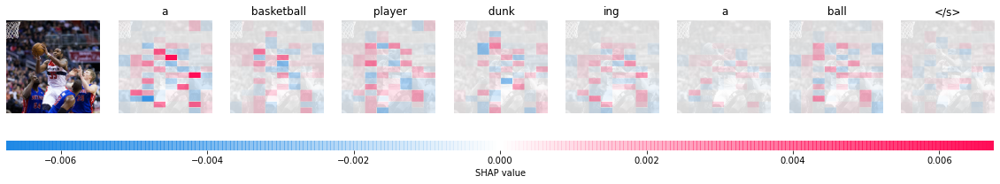


 78%|███████▊  | 116/148 [02:41<00:40,  1.25s/it]
166it [03:43,  1.25s/it]                         
                        
Partition explainer: 2it [03:55, 117.78s/it]              
Fixed_context: 0 Masker_option: inpaint_telea


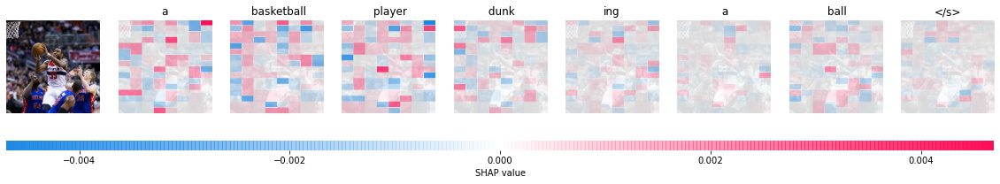


 78%|███████▊  | 116/148 [01:58<00:29,  1.09it/s]
166it [02:57,  1.00it/s]                         
                        
Partition explainer: 2it [03:08, 94.18s/it]               
Fixed_context: 0 Masker_option: inpaint_ns


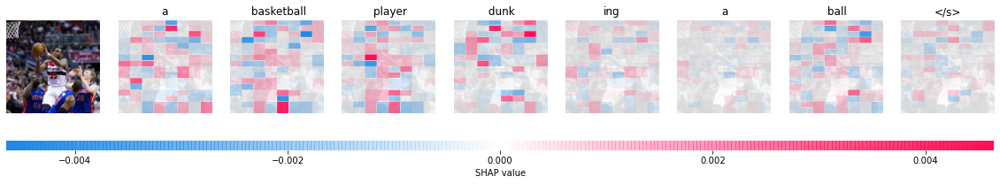


 78%|███████▊  | 116/148 [02:06<00:30,  1.04it/s]
166it [03:03,  1.01s/it]                         
                        
Partition explainer: 2it [03:14, 97.38s/it]               
Fixed_context: 1 Masker_option: blur(56,56)


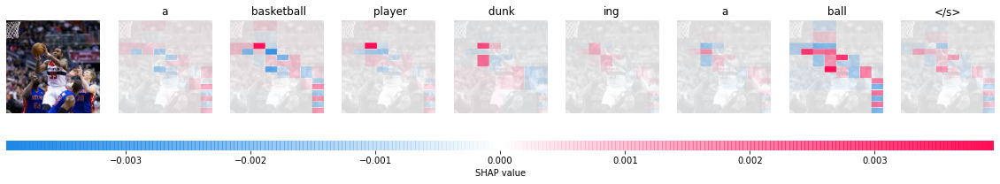

RuntimeError: CUDA error: unknown error

In [13]:
# resetting values for fresh run of for loop 
image_counter = 0 
mask_level_counter = 0 
masked_image_captions = defaultdict(list)
for filename in os.listdir(DIR):
    if filename.endswith(".png"):
        os.remove(DIR+filename)
masked_image_files = defaultdict(list)
show_grid_plot = False
kwargs ={}

image_indexes = [26, 44]
for index in image_indexes:
    for fixed_context_option, masker_option in experiments:
        # get original image caption as input_ids and output_names (refer f_caption and gen_kwargs functions)
        kwargs = f_caption(*X[index:index+1])

        # define a masker that is used to mask out partitions of the input image
        masker = shap.maskers.Image(masker_option, X[index].shape)

        # build a partition explainer with:
        # - the model (a python function)
        # - the masker (a python function)
        # - the partition tree (a python function)
        # - output names (a list of names of the output classes)
        explainer = shap.Explainer(f, masker) #explainer = shap.Explainer(f, masker, model_kwargs = f_caption)

        # here we use 300 evaluations of the underlying model to estimate the SHAP values
        if fixed_context_option is None:
            max_evals = 500 
        else:
            max_evals = 300
        shap_values = explainer(X[index:index+1], max_evals = max_evals, batch_size=50, fixed_context = fixed_context_option)

        # output labels 
        output_names = [kwargs['output_names']] #output_names = explainer.output_names

        # output plot
        print("Fixed_context:", fixed_context_option, "Masker_option:", masker_option)
        shap.image_plot(shap_values, labels = output_names)
        
        # grid plot for masked_images
        if show_grid_plot:
            titles = masked_image_captions[image_counter]
            masked_images = []
            for filename in masked_image_files[image_counter]:
                    image = cv2.imread('{0}/{1}'.format(DIR, filename))
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
                    masked_images.append(image)
            grid_display(masked_images, titles, 4, (20,20))

        # resetting values for loop next iterations
        mask_level_counter = 0 
        image_counter += 1
        kwargs ={}

Partition explainer: 2it [02:42, 81.43s/it]               
Fixed_context: 0 Masker_option: blur(56,56)


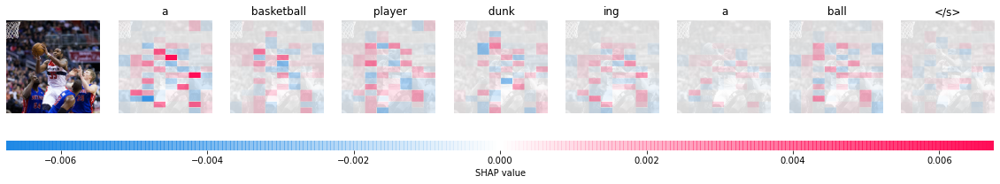

Partition explainer: 2it [03:16, 98.33s/it]               
Fixed_context: 0 Masker_option: inpaint_telea


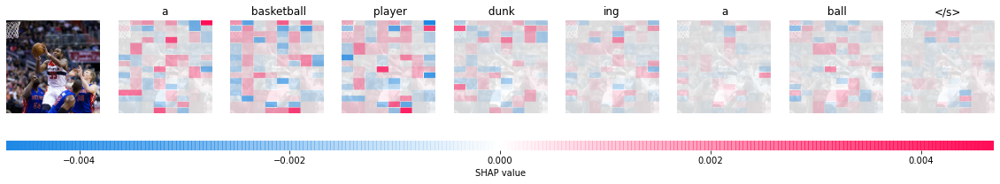

Partition explainer: 2it [02:47, 83.76s/it]               
Fixed_context: 0 Masker_option: inpaint_ns


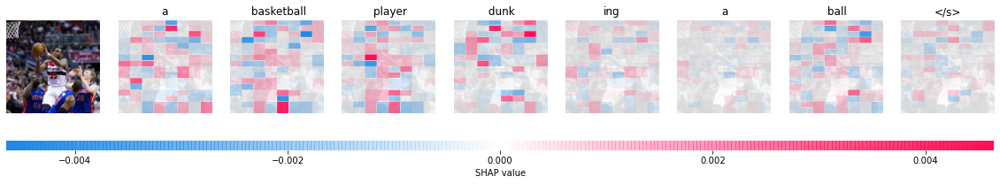

Partition explainer: 2it [03:08, 94.30s/it]               
Fixed_context: 1 Masker_option: blur(56,56)


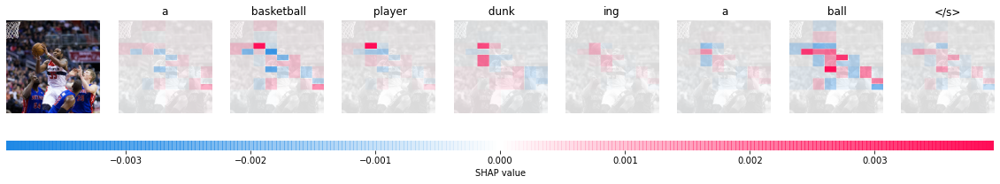

Partition explainer: 2it [03:18, 99.43s/it]               
Fixed_context: 1 Masker_option: inpaint_telea


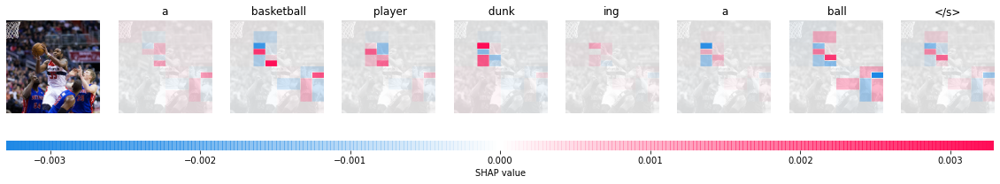

Partition explainer: 2it [03:11, 95.59s/it]               
Fixed_context: 1 Masker_option: inpaint_ns


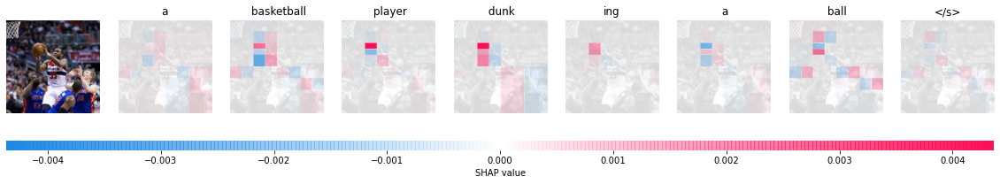

Partition explainer: 2it [19:07, 573.54s/it]              
Fixed_context: None Masker_option: blur(56,56)


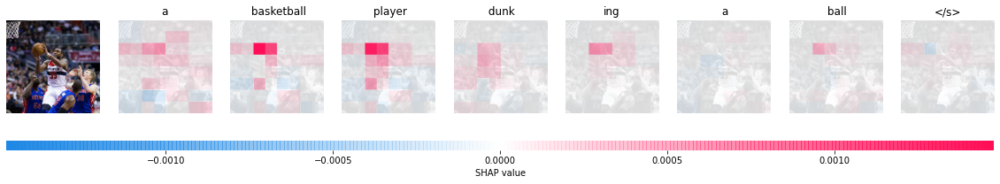

Partition explainer: 2it [06:01, 180.95s/it]              
Fixed_context: None Masker_option: inpaint_telea


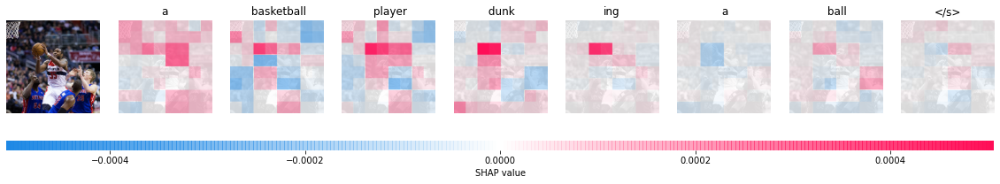

Partition explainer: 2it [05:25, 162.93s/it]              
Fixed_context: None Masker_option: inpaint_ns


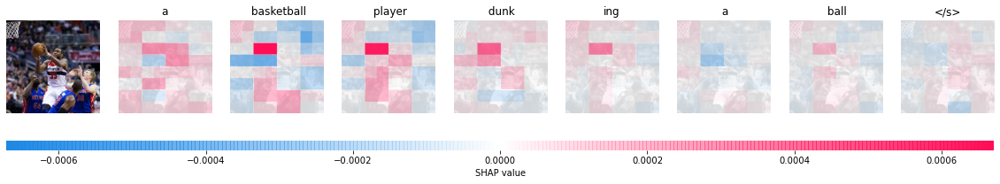

In [10]:
# resetting values for fresh run of for loop 
image_counter = 0 
mask_level_counter = 0 
masked_image_captions = defaultdict(list)
for filename in os.listdir(DIR):
    if filename.endswith(".png"):
        os.remove(DIR+filename)
masked_image_files = defaultdict(list)
show_grid_plot = False
kwargs ={}

image_indexes = [44]
for index in image_indexes:
    for fixed_context_option, masker_option in experiments:
        # get original image caption as input_ids and output_names (refer f_caption and gen_kwargs functions)
        kwargs = f_caption(*X[index:index+1])

        # define a masker that is used to mask out partitions of the input image
        masker = shap.maskers.Image(masker_option, X[index].shape)

        # build a partition explainer with:
        # - the model (a python function)
        # - the masker (a python function)
        # - the partition tree (a python function)
        # - output names (a list of names of the output classes)
        explainer = shap.Explainer(f, masker) #explainer = shap.Explainer(f, masker, model_kwargs = f_caption)

        # here we use 300 evaluations of the underlying model to estimate the SHAP values
        if fixed_context_option is None:
            max_evals = 500 
        else:
            max_evals = 300
        shap_values = explainer(X[index:index+1], max_evals = max_evals, batch_size=50, fixed_context = fixed_context_option)

        # output labels 
        output_names = [kwargs['output_names']] #output_names = explainer.output_names

        # output plot
        print("Fixed_context:", fixed_context_option, "Masker_option:", masker_option)
        shap.image_plot(shap_values, labels = output_names)
        
        # grid plot for masked_images
        if show_grid_plot:
            titles = masked_image_captions[image_counter]
            masked_images = []
            for filename in masked_image_files[image_counter]:
                    image = cv2.imread('{0}/{1}'.format(DIR, filename))
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
                    masked_images.append(image)
            grid_display(masked_images, titles, 4, (20,20))

        # resetting values for loop next iterations
        mask_level_counter = 0 
        image_counter += 1
        kwargs ={}